In [1]:
import sys
sys.path.append("./flask")
import inception_v4
import numpy as np
import cv2, scipy, pymongo
import os, PIL
import tensorflow as tf
import matplotlib.pyplot as plt
import cytoolz as cz
import plotly.plotly as pyy

from sklearn.manifold import TSNE
from sklearn.cluster import KMeans
from keras import backend as K
from random import randint
from plotly import offline as py, graph_objs as go
from pymongo import MongoClient
from odo import odo
from PIL import Image
from tensorflow.python.platform import gfile
from model import get_keras_objects
from pandas import DataFrame


py.init_notebook_mode()

%matplotlib inline

size = 299
folder = "data/images2440"


Using TensorFlow backend.
/usr/local/lib/python2.7/dist-packages/odo/backends/pandas.py:94: FutureWarning:

pandas.tslib is deprecated and will be removed in a future version.
You can access NaTType as type(pandas.NaT)



### Read images and calculate embeddings with inception v4
###  Calculate T-SNE from embeddings and K-Means clustering

In [2]:
client = MongoClient("34.210.179.94")
db = client.brandon
images = db.images.find()
images = list(images)


In [3]:
path_images = []
embeddings = []
clusters = []
tsne_embeddings = []
for data in images:
    path_images.append(data["filename"])
    embeddings.append(data["embeddings"])
    clusters.append(data["clusters"])
    tsne_embeddings.append(data["tsne_embeddings"])

embeddings = np.array(embeddings)
clusters = np.array(clusters)
tsne_embeddings = np.array(tsne_embeddings)
embeddings.shape

(1338, 1536)

### 3D-Graph from clusters

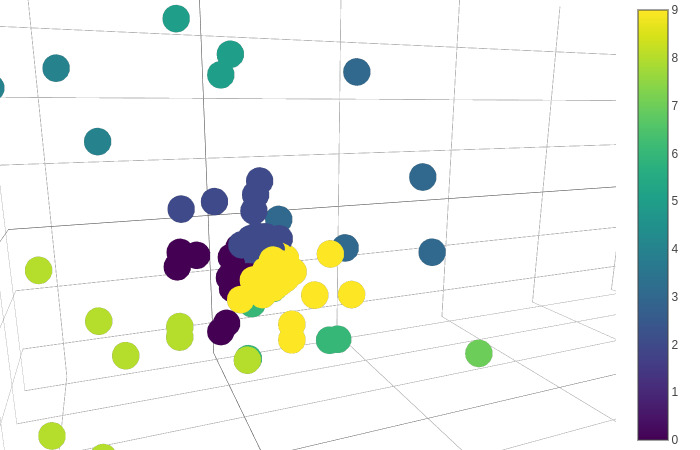

In [4]:
n_clusters = 10
kmeans = KMeans(n_clusters = n_clusters, random_state=0)
tsne_clusters = kmeans.fit_predict(tsne_embeddings)

trace1 = go.Scatter3d(
    x=tsne_embeddings[:,0],
    y=tsne_embeddings[:,1],
    z=tsne_embeddings[:,2],
    mode='markers',
    marker=dict(
    size='16',
    color = tsne_clusters, #set color equal to a variable
    colorscale='Viridis',
    showscale=True
)
)
data = [trace1]
layout = go.Layout(
    margin=dict(
        l=0,
        r=0,
        b=0,
        t=0
    )
)
fig = go.Figure(data=data, layout=layout)

pyy.sign_in('charlielito', 'PMkp55wMgOvYslUMMvSS')
#pyy.image.save_as(fig, filename='3D-plot.png')


from IPython.display import Image
Image('3D-plot.png')
#py.iplot(fig, filename='simple-3d-scatter')

## Images from clusters

Cluster # 1


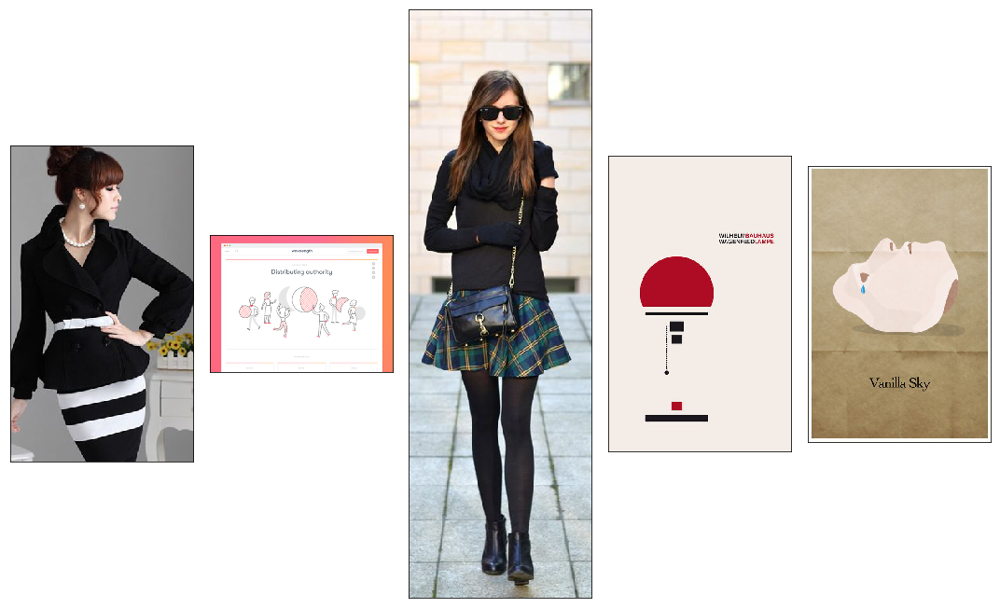

Cluster # 2


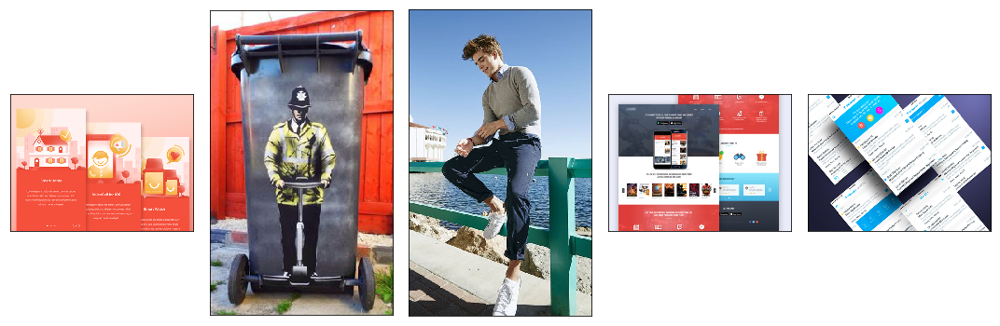

Cluster # 3


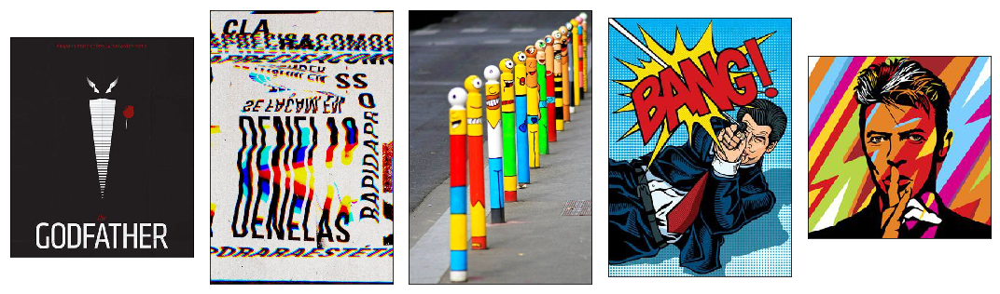

Cluster # 4


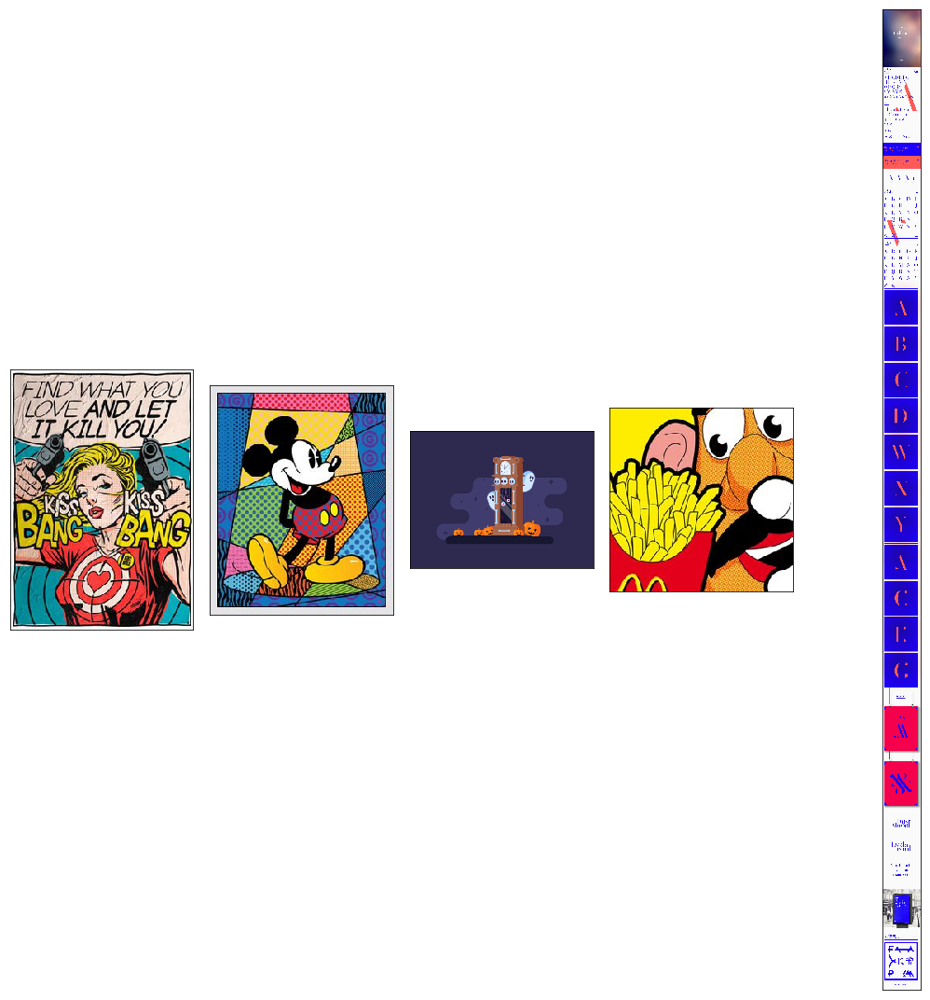

Cluster # 5


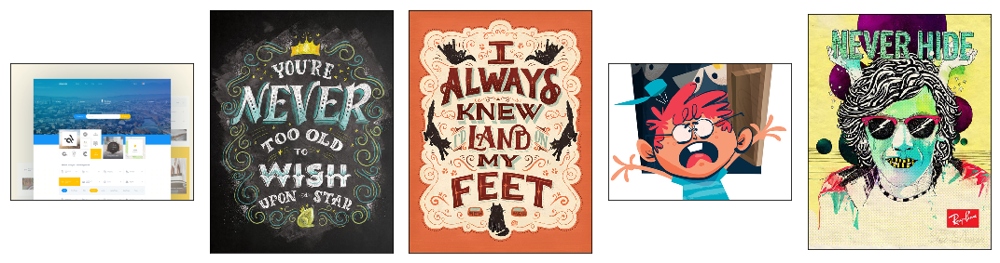

Cluster # 6


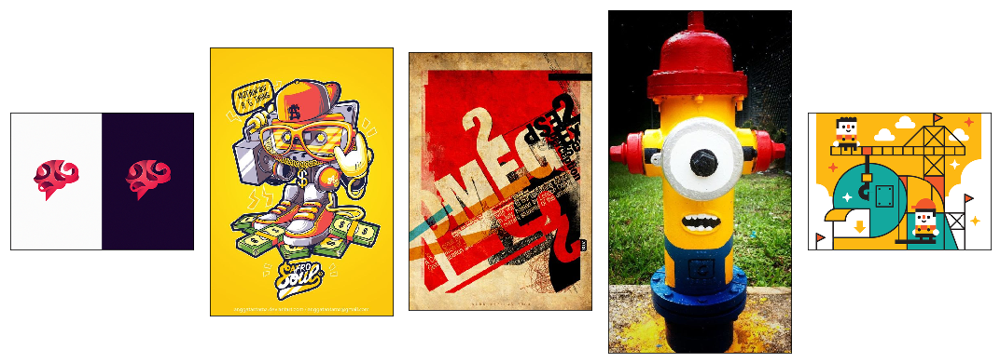

Cluster # 7


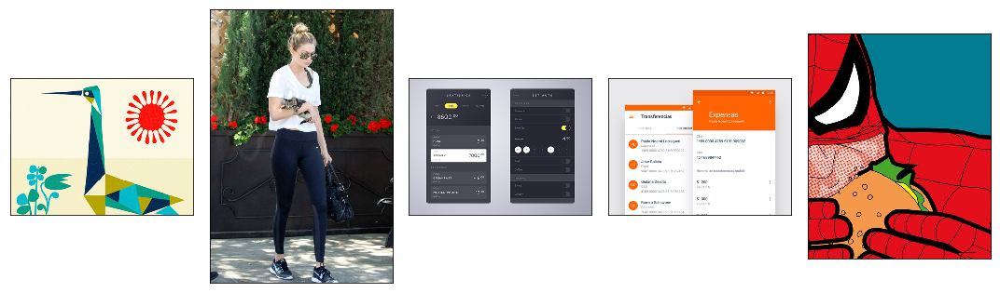

Cluster # 8


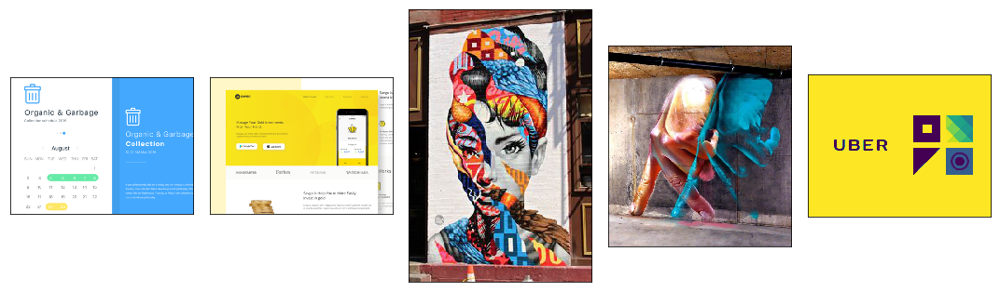

Cluster # 9


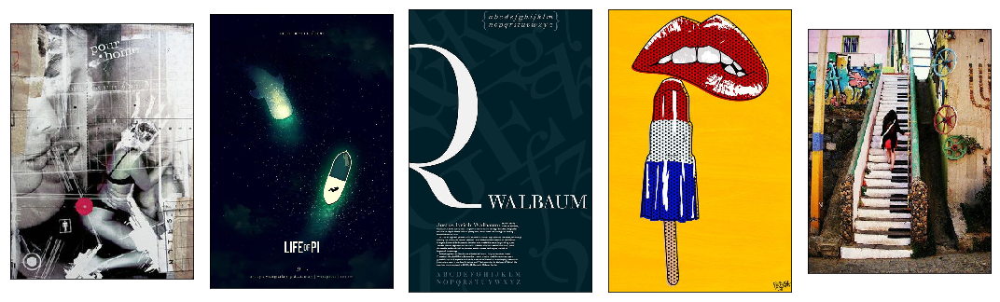

Cluster # 10


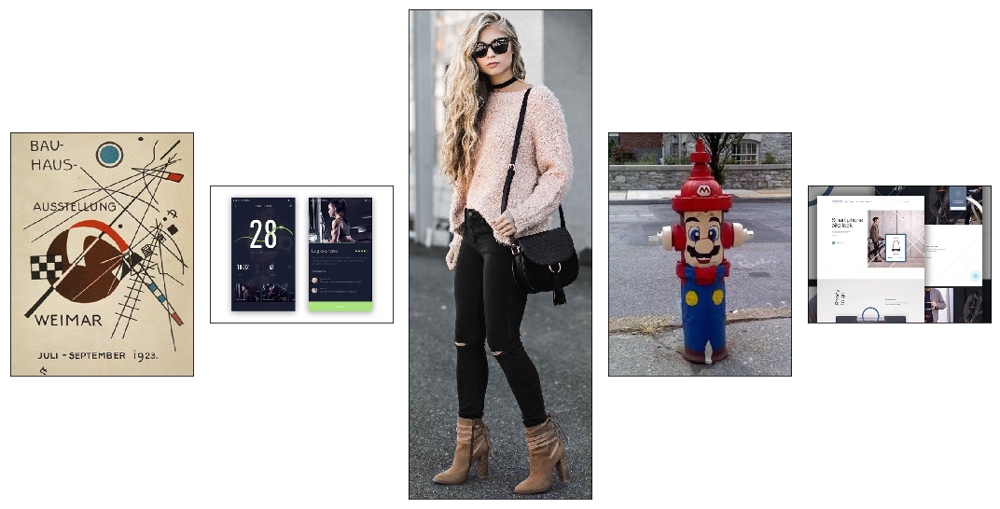

In [5]:
from PIL import Image

n_images = 5

for i in range(n_clusters):
    
    f, axs = plt.subplots(1, n_images, figsize=(15,15))
    
    cluster = np.squeeze(np.argwhere(clusters==i))
    np.random.shuffle(cluster)
    print("Cluster # {}".format(i+1))
    if not (cluster).shape: continue
    for j, index in enumerate(cz.take(n_images, cluster)):
        path = path_images[index]
        #print(index)
        im = Image.open(os.path.join(folder,path))
        fig = axs[j].imshow(np.array(im))
        fig.axes.get_xaxis().set_visible(False)
        fig.axes.get_yaxis().set_visible(False)
    
    f.tight_layout()
    plt.show()

### Closest images from random samples

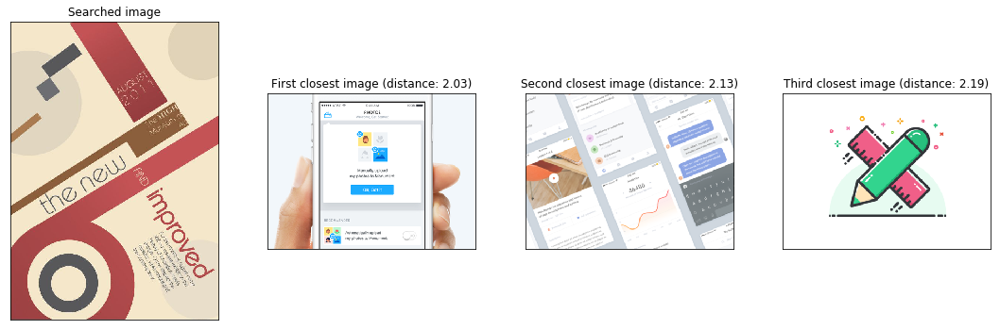

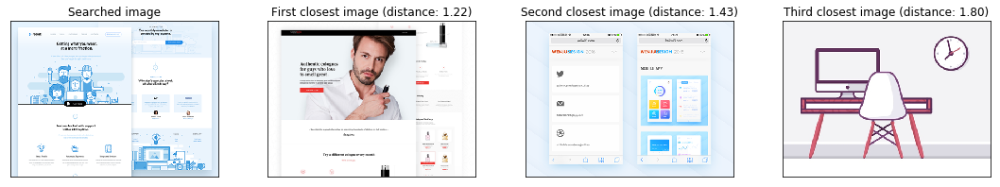

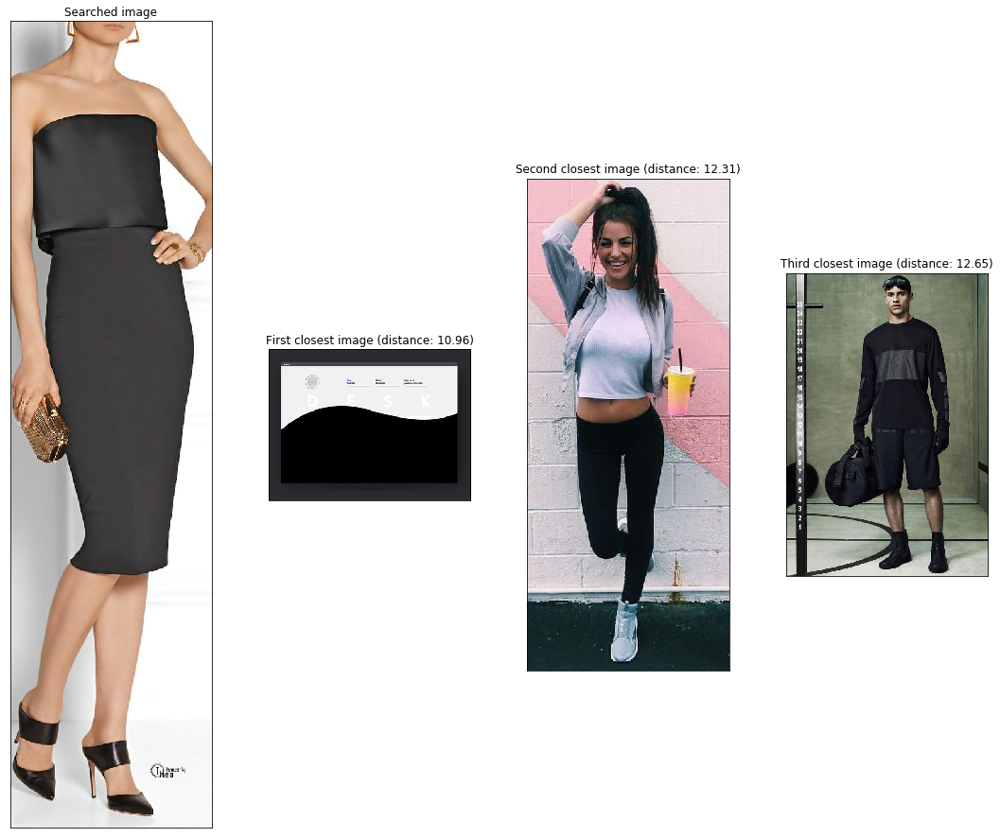

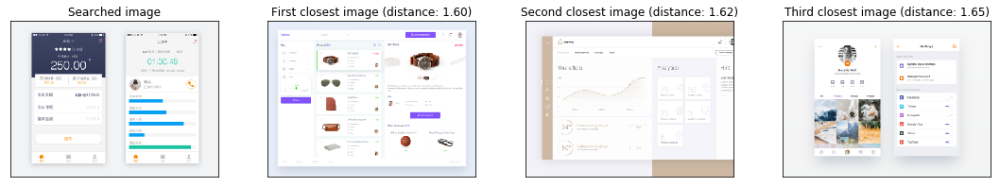

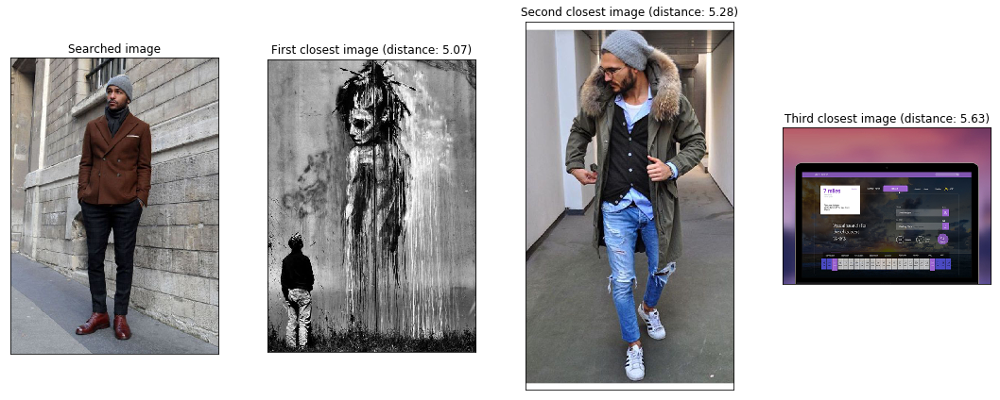

...

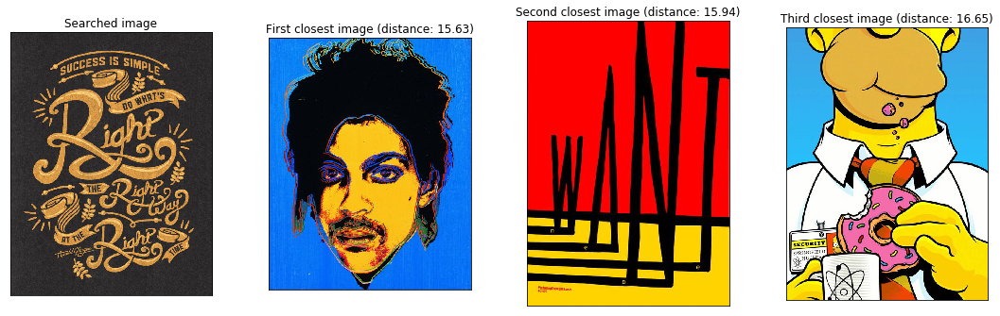

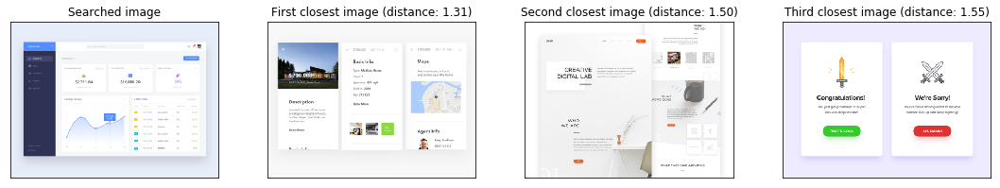

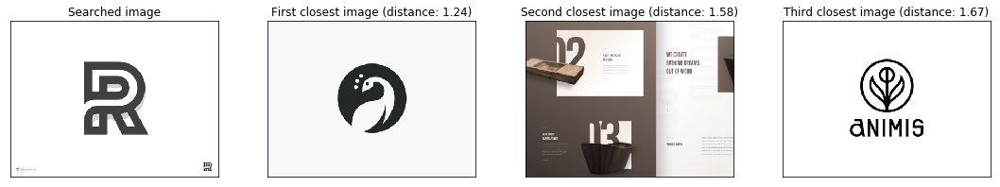

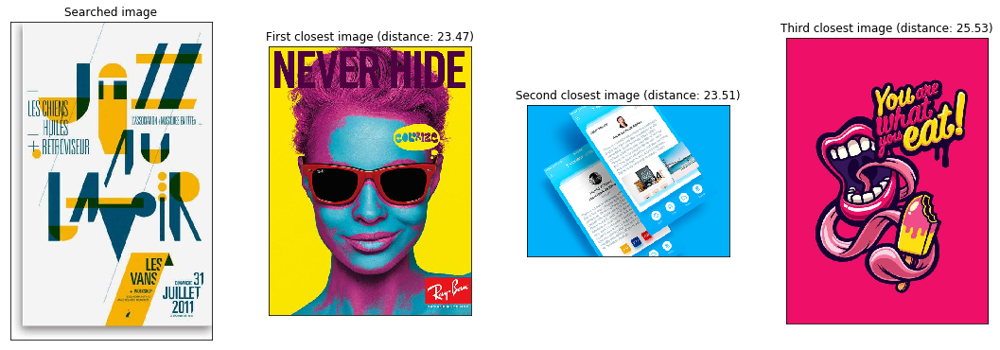

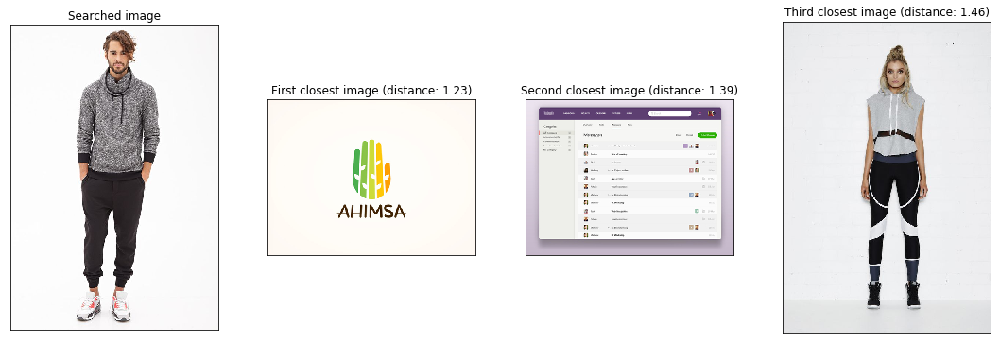

In [6]:
n_samples = 40
n_images = 4

titles = [" ", "First", "Second", "Third"]

for i in range(n_samples):
    
    f, axs = plt.subplots(1, n_images, figsize=(15,15))
    
    sample = randint(0, len(embeddings)-1)
    sample_image_reduced = embeddings[sample]

    distances = np.array((map(lambda x: scipy.spatial.distance.euclidean(x,sample_image_reduced), embeddings)))

    sort_index = np.argsort(distances)
    
    for j in range(n_images):
        if j == 0:
            title = "Searched image"
        else:
            title = "{} closest image ".format(titles[j]) + "(distance: {0:.2f})".format(distances[sort_index[j]])
        path = path_images[sort_index[j]]
      
        im = Image.open(os.path.join(folder,path))
        fig = axs[j].imshow(np.asarray(im))
        axs[j].set_title(title)
        fig.axes.get_xaxis().set_visible(False)
        fig.axes.get_yaxis().set_visible(False)
        
    
    f.tight_layout()
    plt.show()